1. 감마보정

In [1]:
# OpenCV의 출력 함수 예시
import cv2
import matplotlib.pyplot as plt
img = cv2.imread("../data/images/yummy.jpg")
cv2.imshow("original", img)
cv2.waitKey(0)

-1

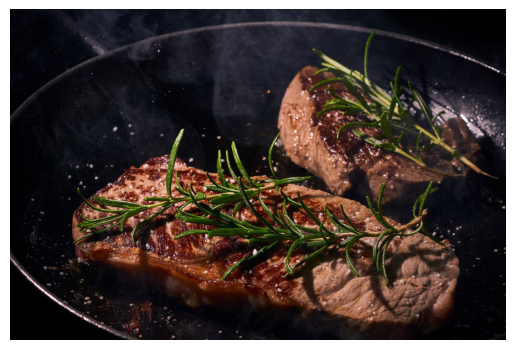

In [2]:
# 감마 보정
# 감마값 1보다 크면 밝아지고, 작으면 어두워짐
import cv2
import matplotlib.pyplot as plt
img = cv2.imread("../data/images/yummy.jpg")
image_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
# openCV =  BRG
# matplotlib =  RGB
plt.imshow(image_rgb)
plt.axis("off")
plt.show()

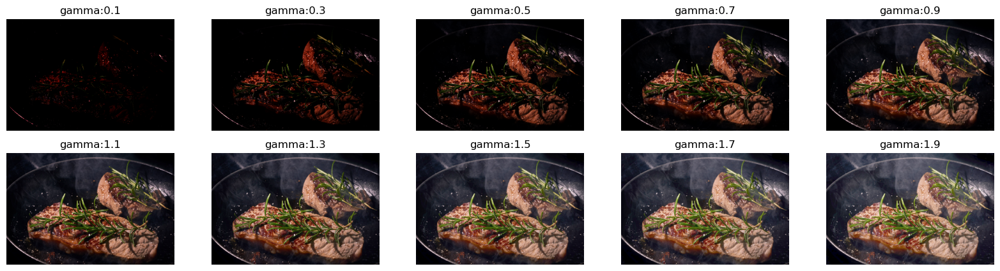

In [3]:
import numpy as np
plt.figure(figsize=(20,5))
gamma = np.arange(0.1, 2.0, 0.2)
for i, g in enumerate(gamma):
    plt.subplot(2, 5, i+1)
    out = image_rgb.copy()
    out = image_rgb.astype(np.float64)
    out = ((out / 255) ** (1 / g)) * 255
    out = out.astype(np.uint8)
    plt.title(f'gamma:{g:.1f}')
    plt.imshow(out)
    plt.axis("off")
plt.show()

2. 대칭

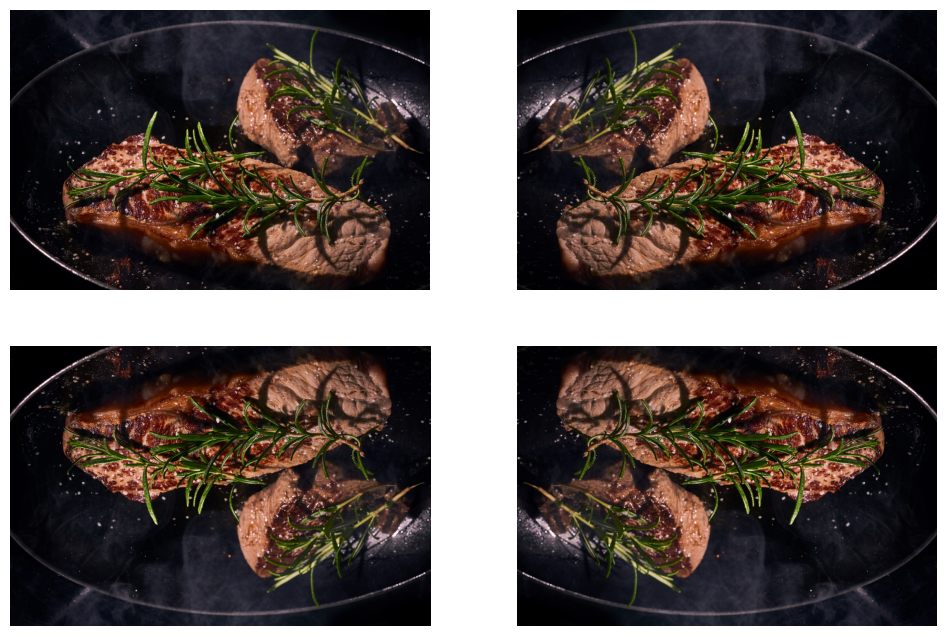

In [4]:
import cv2
import matplotlib.pyplot as plt

plt.figure(figsize=(12,8))
img = cv2.imread("../data/images/yummy.jpg")
image_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.subplot(2,2,1)
plt.imshow(image_rgb)
plt.axis("off")
options=[1,0,-1] # 좌우, 상하, 상하좌우
for idx,option in enumerate(options):
    dst = cv2.flip(img, option)
    image_rgb = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)
    plt.subplot(2,2,idx+2)
    plt.imshow(image_rgb)
    plt.axis("off")
plt.show()

3. 색상반전

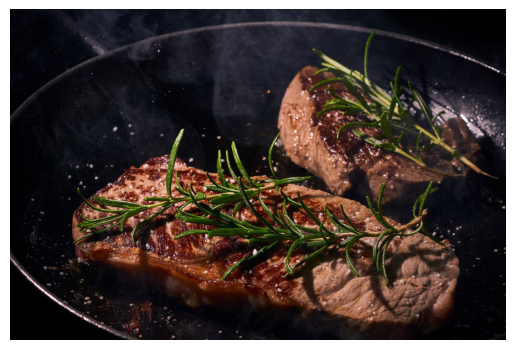

In [5]:
# 색상 반전: 어두운 부분은 밝게, 밝은 부분은 어둡게
# 255 - 픽셀값
# 200 => 255 - 200 = 55
import cv2
import matplotlib.pyplot as plt
img = cv2.imread("../data/images/yummy.jpg")
image_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(image_rgb)
plt.axis("off")
plt.show()

[[12  4  4]
 [13  5  5]
 [13  5  5]
 [14  6  6]
 [13  5  5]]
[[243 251 251]
 [242 250 250]
 [242 250 250]
 [241 249 249]
 [242 250 250]]


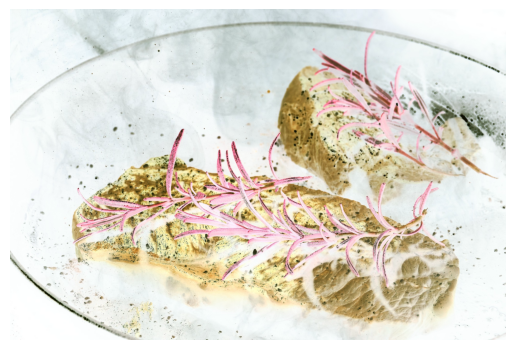

In [6]:
out = img.copy()
print(out[0][0:5])
out = 255 - out
print(out[0][0:5])
plt.imshow(out)
plt.axis("off")
plt.show()

4. 이진화

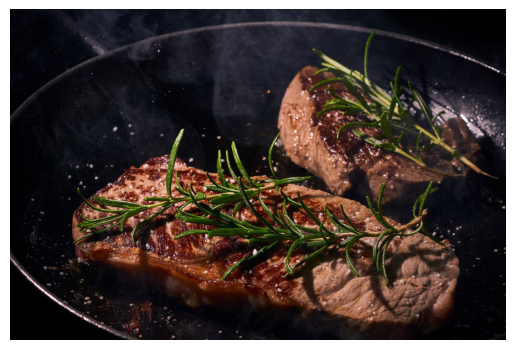

In [7]:
# 영상 이진화
# 특정한 경계값을 기준으로 0,255로 만드는 작업
# 경계가 뚜렷해짐
import cv2
import matplotlib.pyplot as plt

img = cv2.imread("../data/images/yummy.jpg")
image_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(image_rgb)
plt.axis("off")
plt.show()

In [8]:
# 픽셀값 127을 기준으로 0,255로 나누는 작업
ret, dst = cv2.threshold(image_rgb, 127, 255, cv2.THRESH_BINARY)
# print(ret) #경계값
# print(dst) #출력값

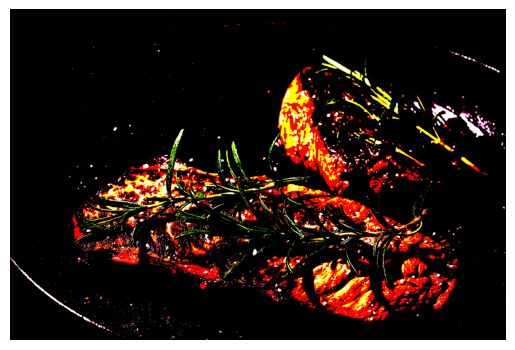

In [9]:
plt.imshow(dst, cmap="gray")
plt.axis("off")
plt.show()

5. 적응형 이진화

In [10]:
# Adaptive Threshold, 적응형 이진화 : 픽셀마다 다른 임계값을 적용하는 방식
# 전역 이진화 : 모든 픽셀에 같은 임계값을 적용하는 방식. 이진화를 수해하는 방식
# 예) 조명의 변화나 반사가 심한 경우

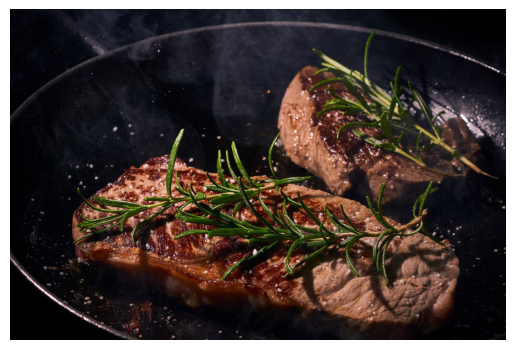

In [11]:
import cv2
import matplotlib.pyplot as plt
img = cv2.imread("../data/images/yummy.jpg")
image_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(image_rgb)
plt.axis("off")
plt.show()

In [12]:
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
# adaptiveThreshold(입력이미지, 최대값, 적응형 이진화 플래그, 임계값 형식, 블록 크기, 감산값)
# cv2.ADAPTIVE_THRESH_MEAN_C : 모든 픽셀에 평균 가중치 적용
# cv2.ADAPTIVE_THRESH_GAUSSIAN_C : 모든 픽셀에 중심점으로부터의 거리에 대한 가중치 적용
# binary = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 467, 37)
binary = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 467, 37)

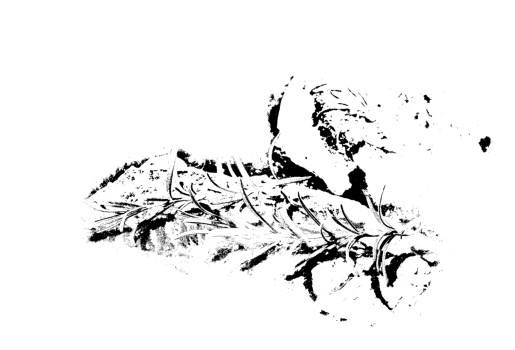

In [13]:
image_rgb = cv2.cvtColor(binary, cv2.COLOR_BGR2RGB)
plt.imshow(image_rgb)
plt.axis("off")
plt.show()

6. 회전

In [14]:
import cv2
img = cv2.imread("../data/images/penguin.png")
image_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

In [15]:
height, width, channel = img.shape
degrees=[45,90,180,270]
images=[]
for degree in degrees:
    # 회전중심좌표, 각도, 축소/확대비율
    matrix = cv2.getRotationMatrix2D((width/2, height/2), degree, 1)
    dst = cv2.warpAffine(img, matrix, (width, height))
    images.append(dst)

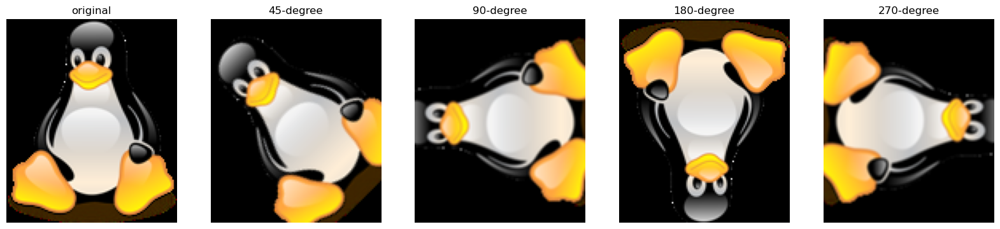

In [16]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,5))
plt.subplot(1,5,1)
plt.imshow(image_rgb)
plt.title('original')
plt.axis("off")
for idx,image in enumerate(images):
    plt.subplot(1,5,idx+2)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    plt.imshow(image)
    plt.title(f'{degrees[idx]}-degree')
    plt.axis("off")
    idx+=1
plt.show()

7. 범위강조

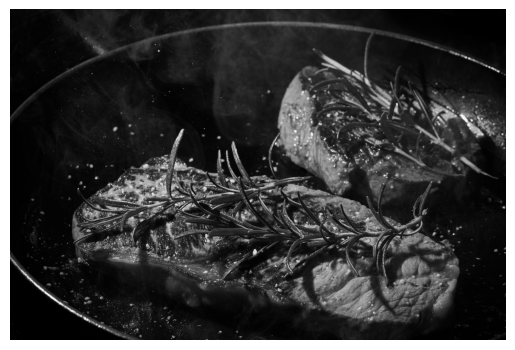

In [17]:
# 범위 강조 : 일정 범위의 픽셀만 두드러지게 만드는 방법
# 명암 대조가 뚜렷해지고 해당 부분이 돋보이는 효과
import cv2
import matplotlib.pyplot as plt

img = cv2.imread("../data/images/yummy.jpg")
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
plt.imshow(gray, cmap='gray')
plt.axis("off")
plt.show()

In [18]:
out = gray.copy()
height, width = gray.shape
print(height, width)

1280 1920


In [19]:
low = 150
high = 160
print(out[50][:30])
for row in range(height):
    for col in range(width):
        if low <= out[row][col] <= high:
            out[row][col] = 255
print(out[50][:30])

[3 4 5 5 4 4 4 5 5 5 5 5 5 5 5 5 5 5 6 6 6 6 6 6 6 6 5 5 5 5]
[3 4 5 5 4 4 4 5 5 5 5 5 5 5 5 5 5 5 6 6 6 6 6 6 6 6 5 5 5 5]


8. 축소, 확대

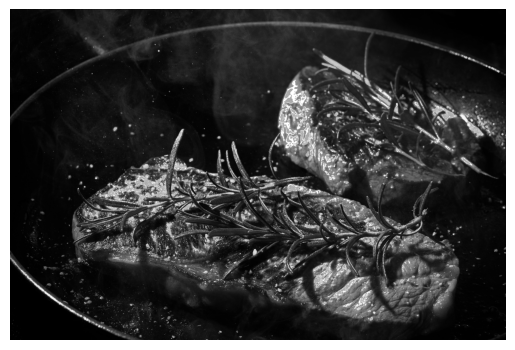

(128, 107, 3)

In [20]:
plt.imshow(out,cmap='gray')
plt.axis("off")
plt.show()
import cv2
import matplotlib.pyplot as plt
img = cv2.imread("../data/images/penguin.png")
image_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
image_rgb.shape

In [21]:
print(img.shape)
dst = cv2.pyrUp(img) # 2배 확대
print(dst.shape)
dst2 = cv2.pyrDown(img) # 2배 축소
print(dst2.shape)

(128, 107, 3)
(256, 214, 3)
(64, 54, 3)


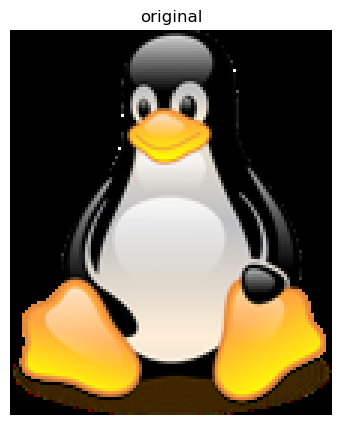

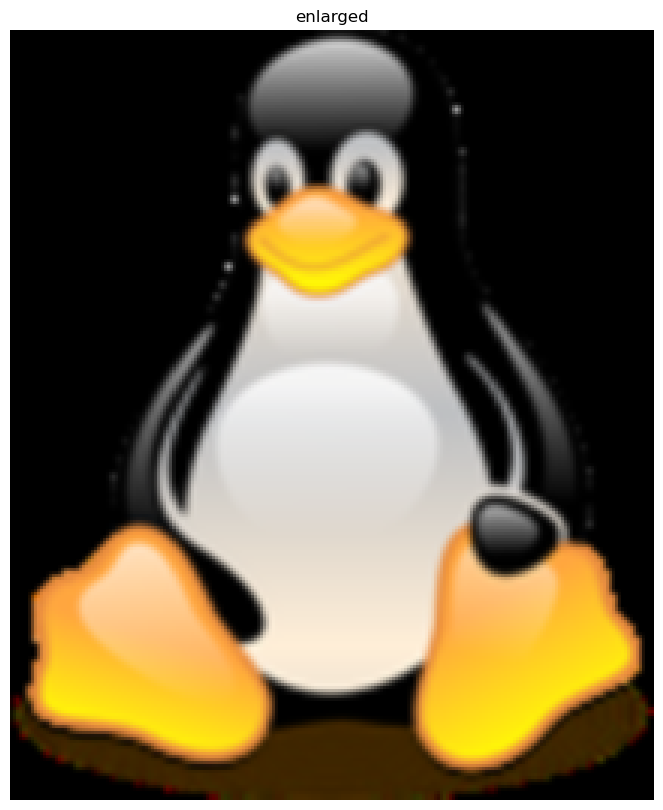

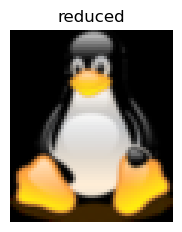

In [22]:
width=10
height=5
plt.figure(figsize=(width,height))
plt.imshow(image_rgb)
plt.title('original')
plt.axis("off")
plt.show()
plt.figure(figsize=(width*2,height*2))
image_rgb = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)
plt.imshow(image_rgb)
plt.title('enlarged')
plt.axis("off")
plt.show()
plt.figure(figsize=(width*0.5,height*0.5))
image_rgb = cv2.cvtColor(dst2, cv2.COLOR_BGR2RGB)
plt.imshow(image_rgb)
plt.title('reduced')
plt.axis("off")
plt.show()

9. resize

In [23]:
import cv2
import matplotlib.pyplot as plt
img = cv2.imread("../data/images/penguin.png")
image_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
image_rgb.shape

(128, 107, 3)

In [24]:
# 절대크기 dsize(width, height)
dst = cv2.resize(img, dsize=(640, 500))
print(dst.shape)

# 상대크기 fx (width), fy (height)
dst2 = cv2.resize(img, dsize=(0, 0), fx=0.3, fy=0.5)
print(dst2.shape)

(500, 640, 3)
(64, 32, 3)


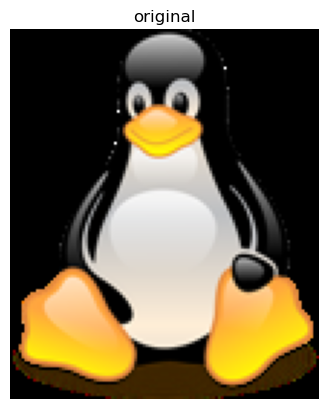

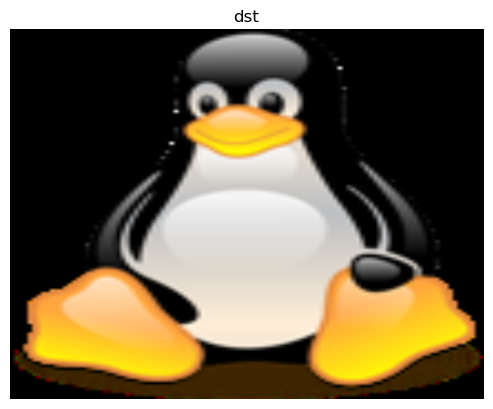

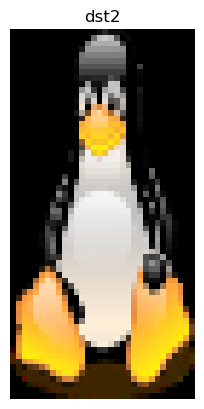

In [25]:
plt.imshow(image_rgb)
plt.title('original')
plt.axis("off")
plt.show()

image_rgb = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)
plt.imshow(image_rgb)
plt.title('dst')
plt.axis("off")
plt.show()

image_rgb = cv2.cvtColor(dst2, cv2.COLOR_BGR2RGB)
plt.imshow(image_rgb)
plt.title('dst2')
plt.axis("off")
plt.show()

10. 명암대비스트레칭

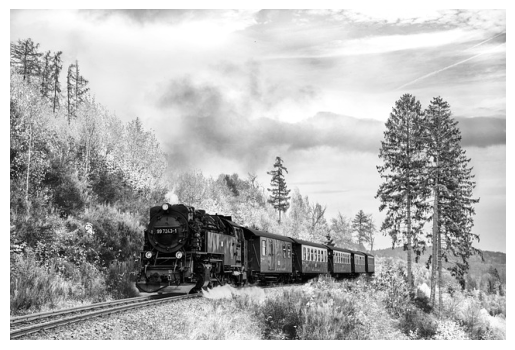

In [26]:
# 명암대비 스트레칭 : 명암대비가 낮은 영상을 명암대비가 높은 영상으로 늘려주는 작업
import cv2
import matplotlib.pyplot as plt
img = cv2.imread("../data/images/winter.jpg")
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
plt.imshow(gray,cmap='gray')
plt.axis("off")
plt.show()

In [27]:
out = gray.copy()
height, width = gray.shape
height, width

(427, 640)

In [28]:
# 명도값 = ((원래값 - 최저명도값) * 255) / (최고명도값 - 최저명도값)

In [29]:
# 밝게 하는 경우
low = 75
high = 255
low, high
for i in range(height):
    for j in range(width):
        out[i][j] = ((gray[i][j] - low) * 255 / (high - low))

In [30]:
# 어둡게 하는 경우
low = 0
high = 200
low, high
for i in range(height):
    for j in range(width):
        out[i][j] = ((gray[i][j] - low) * 255 / (high - low))

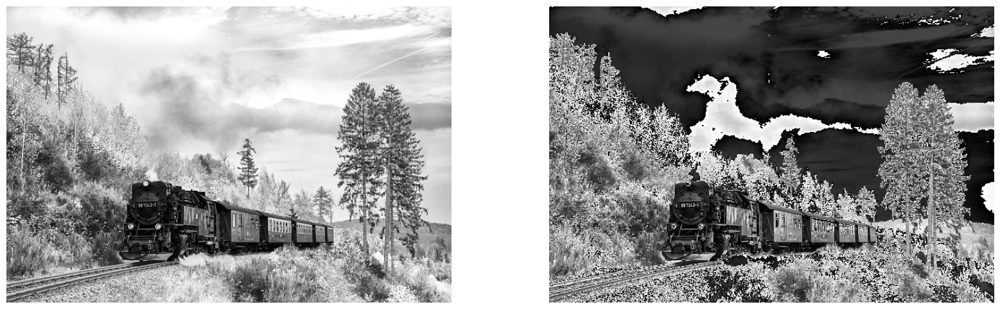

In [31]:
plt.figure(figsize=(20,6))
plt.subplot(1, 2, 1)
plt.imshow(gray,cmap='gray')
plt.axis("off")
plt.subplot(1, 2, 2)
plt.imshow(out,cmap='gray')
plt.axis("off")
plt.show()

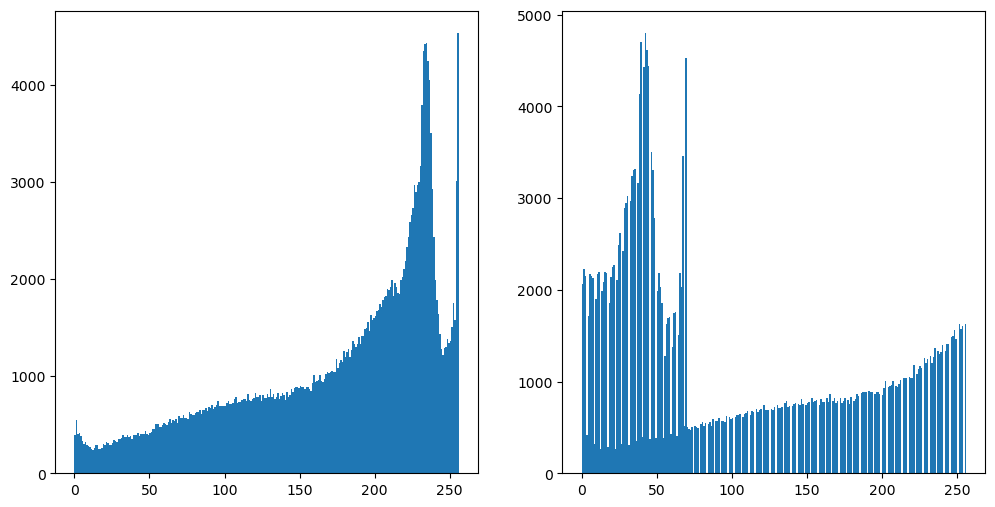

In [32]:
plt.figure(figsize=(12,6))
plt.subplot(1, 2, 1)
plt.hist(gray.ravel(), 256, [0, 256])
plt.subplot(1, 2, 2)
plt.hist(out.ravel(), 256, [0, 256])
plt.show()
# 픽셀에 대한 히스토그램, 밝기에 해당하는 명도값
# 왼쪽으로 치우쳐 있으면 명암대비가 낮은 이미지, 오른쪽으로 치우쳐있으면 명암대비가 높은 이미지

11. end-in 기법

In [33]:
# end-in 기법
# 스트레칭 기법 + 양 끝 일정 부분을 잘라내어 이미지의 명암 대비가 더 뚜렷하게 보이게 하는 기법

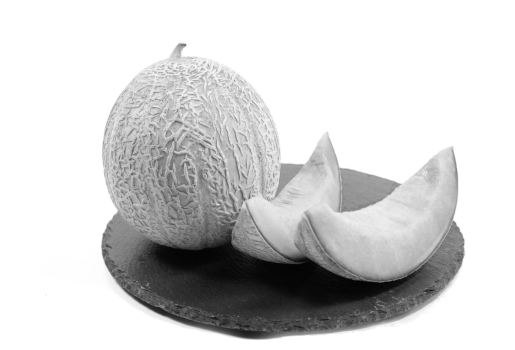

In [34]:
import cv2
import matplotlib.pyplot as plt
img = cv2.imread('../data/images/melon.jpg')
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
plt.imshow(gray, cmap='gray')
plt.axis('off')
plt.show()

In [35]:
out = gray.copy()
height, width = gray.shape
height, width

(853, 1280)

In [36]:
MIN = 30
MAX = 255
print(MIN, MAX)
# MIN = 0
# MAX = 200
# print(MIN, MAX)

30 255


In [37]:
low = 10
high = 240
# 10 이하는 0, 240 이상은 255(양쪽 잘리는 부분)
low, high

(10, 240)

In [38]:
for i in range(height):
    for j in range(width):
        if gray[i][j] <= low:
            out[i][j] = 0
        elif gray[i][j] >= high:
            out[i][j] = 255
        else:
            out[i][j] = ((gray[i][j] - MIN) * 255) / (MAX - MIN)

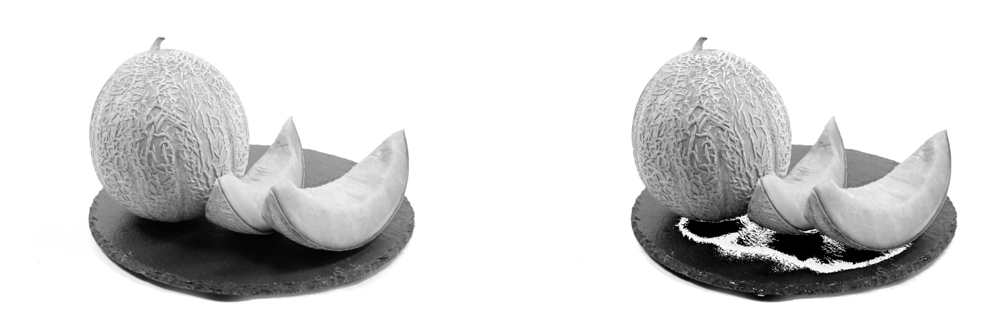

In [39]:
plt.figure(figsize=(20,6))
plt.subplot(1, 2, 1)
plt.imshow(gray,cmap='gray')
plt.axis("off")
plt.subplot(1, 2, 2)
plt.imshow(out,cmap='gray')
plt.axis("off")
plt.show()

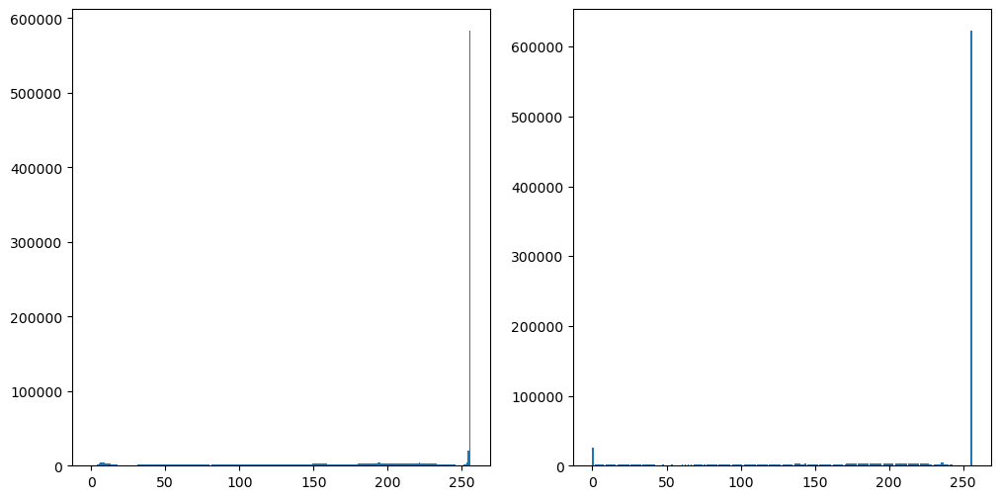

In [40]:
plt.figure(figsize=(12,6))
plt.subplot(1, 2, 1)
plt.hist(gray.ravel(), 256, [0, 256])
plt.subplot(1, 2, 2)
plt.hist(out.ravel(), 256, [0, 256])
plt.show()
# 픽셀에 대한 히스토그램, 밝기에 해당하는 명도값
# 왼쪽으로 치우쳐 있으면 명암대비가 낮은 이미지, 오른쪽으로 치우쳐있으면 명암대비가 높은 이미지

12. 흐림효과

In [41]:
import cv2
import matplotlib.pyplot as plt
img = cv2.imread("../data/images/winter.jpg")
image_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
image_rgb.shape

(427, 640, 3)

In [42]:
dst = cv2.blur(img, (9, 9)) #커널 사이즈(값이 클수록 흐려짐)

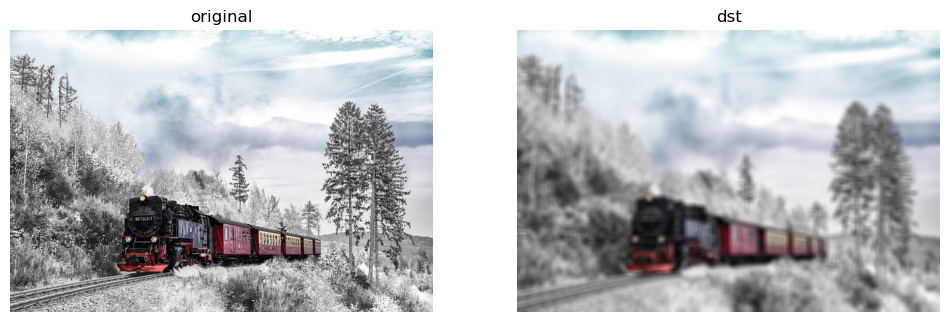

In [43]:
plt.figure(figsize=(12,8))
plt.subplot(1,2,1)
plt.imshow(image_rgb)
plt.title('original')
plt.axis("off")
plt.subplot(1,2,2)
image_rgb = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)
plt.imshow(image_rgb)
plt.title('dst')
plt.axis("off")
plt.show()

13. 히스토그램 평탄화

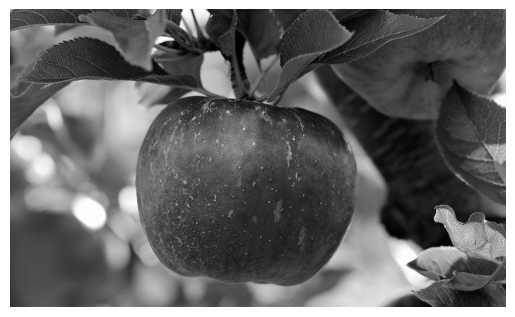

In [44]:
# Histogram equalization, 히스토그램 평탄화
# 히스토그램이 특정 영역에 집중되어 있는 부분을 평탄하게 만들어주는 작업
import cv2
import matplotlib.pyplot as plt
img = cv2.imread("../data/images/apple.jpg")
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
plt.imshow(gray,cmap='gray')
plt.axis("off")
plt.show()

In [45]:
import numpy as np
histogram, bin = np.histogram(img.ravel(), 256, [0, 256])
cumsum = histogram.cumsum()
# LUT(Look Up Table, 룩업 테이블)
# A = B의 집합, A를 입력하면 B가 리턴됨, 반복문을 돌리는 것보다 빠른 연산 속도
LUT = np.uint8((cumsum - cumsum.min()) * 255 / (cumsum.max() - cumsum.min()))
equ = LUT[gray]
hist = cv2.equalizeHist(gray) #gray 이미지에만 적용 가능

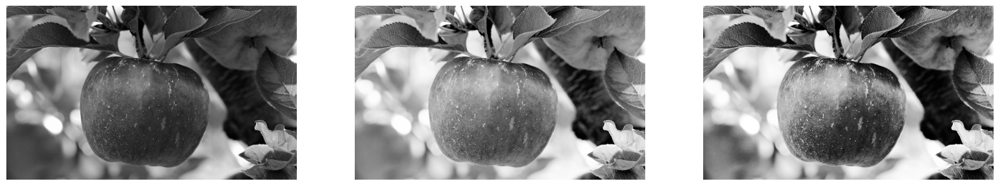

In [46]:
plt.figure(figsize=(20,6))
plt.subplot(1, 3, 1)
plt.imshow(gray,cmap='gray')
plt.axis("off")
plt.subplot(1, 3, 2)
plt.imshow(equ,cmap='gray')
plt.axis("off")
plt.subplot(1, 3, 3)
plt.imshow(hist,cmap='gray')
plt.axis("off")
plt.show()

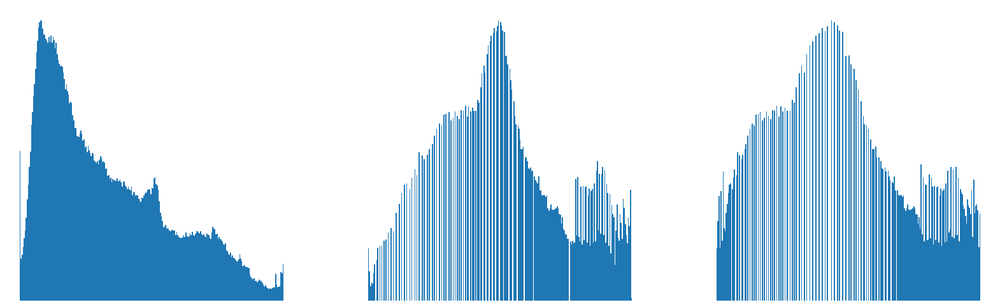

In [47]:
plt.figure(figsize=(20,6))
plt.subplot(1, 3, 1)
plt.hist(img.ravel(), 256, [0, 256])
plt.axis("off")
plt.subplot(1, 3, 2)
plt.hist(equ.ravel(), 256, [0, 256])
plt.axis("off")
plt.subplot(1, 3, 3)
plt.hist(hist.ravel(), 256, [0, 256])
plt.axis("off")
plt.show()
# 그림1(원본): 왼쪽으로 치우친 히스토그램
# 그림2: 직접 계산
# 그림3: 함수로 계산

14. 히스토그램 명세화

In [48]:
# 히스토그램 명세화 : 히스토그램이 한쪽으로 치우친 영상을 조정하여 명암대비를 개선시키는 기법
# 1. 원본 영상을 평탄화
# 2. 원하는 히스토그램 모양(타깃 히스토그램)에 해당하는 히스토그램을 평탄화한다. 원본 영상이 왼쪽으로 치우쳐있다면(어두움) 중앙이나 오른쪽에 치우친 영상의 히스토그램을 만들고 평탄화 작업
# 3. 평탄화된 타겟 히스토그램을 다시 역 평탄화
# 4. 역평탄화된 타깃 히스토그램에 해당하는 LUT(룩 업 테이블)을 가지고 평탄화된 원본 영상에 매칭

# 명도 정규화된 누적합 역히스토그램 값
# 0 0 0
# 1 0 3
# 2 0 3
# 3 1.42 4
# 4 2.84 5
# 5 5 5
# 역히스토그램값은 정규화된 누적합과 가장 가까운 값으로 설정
# 명도 1의 경우 1.42 와 가장 가까우므로 3
# 명도 4의 경우 5 와 가장 가까우므로 5

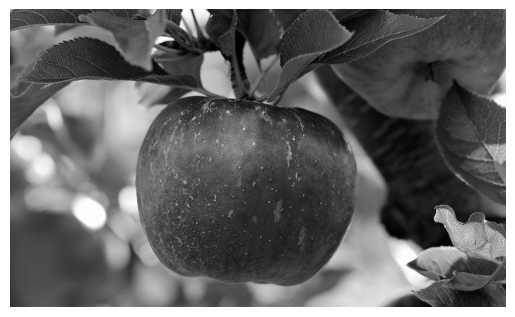

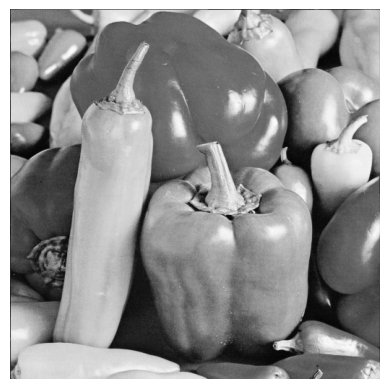

In [49]:
import cv2
import matplotlib.pyplot as plt
img = cv2.imread("../data/images/apple.jpg")
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
# 히스토그램을 참조하기 위한 이미지(히스토그램을 직접 구성하는 것보다는 다른 이미지의 히스토그램을 참조하는 방법)
target = cv2.imread('../data/images/peppers.png')
target_gray = cv2.cvtColor(target, cv2.COLOR_BGR2GRAY)
plt.imshow(gray,cmap='gray')
plt.axis("off")
plt.show()
plt.imshow(target_gray,cmap='gray')
plt.axis("off")
plt.show()

In [50]:
# 마스크 배열
import numpy as np
mask = np.ma.less_equal([-2,-3,-1,0], -1)
mask

masked_array(data=[ True,  True,  True, False],
             mask=False,
       fill_value=True)

In [51]:
import numpy as np
import numpy.ma as ma
# 네번째 항목을 유효하지 않은 것으로 표시
x = np.array([1, 2, 3, -1, 5])

# 마스크 배열:
mx = ma.masked_array(x, mask=[0, 0, 0, 1, 0]) # 네번째 값에 마스크 처리
mx

# 마스킹된 값을 제외한 평균값
# print(mx.mean())

masked_array(data=[1, 2, 3, --, 5],
             mask=[False, False, False,  True, False],
       fill_value=999999)

In [52]:
# 원본과 참조 이미지의 누적합의 차이 계산
import numpy as np
shape = gray.shape
original = gray.ravel()
specified = target_gray.ravel()
s_values, bin_idx, s_counts = np.unique(original, return_inverse=True, return_counts=True)
t_values, t_counts = np.unique(specified, return_counts=True)
s_quantiles = np.cumsum(s_counts).astype(np.float64)
s_quantiles /= s_quantiles[-1] #가장 큰 값(마지막값)으로 나눔
sour = np.around(s_quantiles * 255) # 255를 곱하고 반올림 처리
t_quantiles = np.cumsum(t_counts).astype(np.float64)
t_quantiles /= t_quantiles[-1]
temp = np.around(t_quantiles * 255)
b = []
for data in sour:
    diff = temp - data
    mask = np.ma.less_equal(diff, -1) # -1 이하이면 True, 아니면 False
    if np.all(mask): # 모두 True이면(모두 -1이면) True, 아니면 False
        c = np.abs(diff).argmin()
        b.append(c)
    masked_diff = np.ma.masked_array(diff, mask)
    b.append(masked_diff.argmin()) #가장 작은 값 입력
b=np.array(b)
out = np.array(b[bin_idx].reshape(shape))

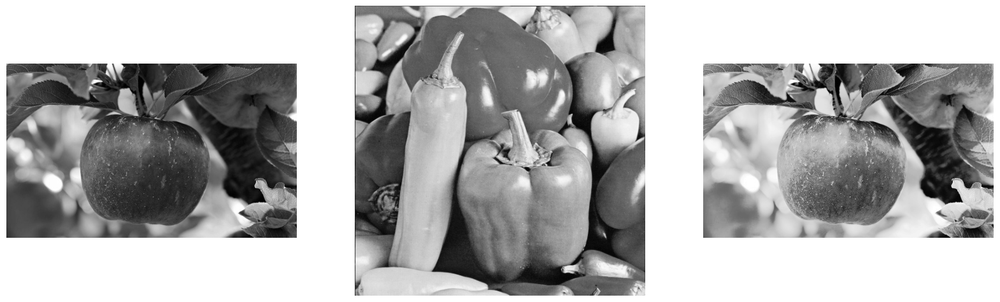

In [53]:
plt.figure(figsize=(20,6))
plt.subplot(1, 3, 1)
plt.imshow(gray,cmap='gray')
plt.axis("off")
plt.subplot(1, 3, 2)
plt.imshow(target_gray,cmap='gray')
plt.axis("off")
plt.subplot(1, 3, 3)
plt.imshow(out,cmap='gray')
plt.axis("off")
plt.show()

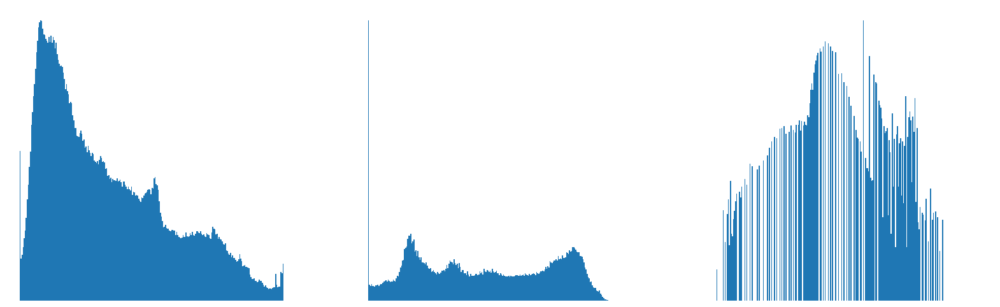

In [54]:
plt.figure(figsize=(20,6))
plt.subplot(1, 3, 1)
plt.hist(img.ravel(), 256, [0, 256])
plt.axis("off")
plt.subplot(1, 3, 2)
plt.hist(target.ravel(), 256, [0, 256])
plt.axis("off")
plt.subplot(1, 3, 3)
plt.hist(out.ravel(), 256, [0, 256])
plt.axis("off")
plt.show()
# 그림1(원본): 왼쪽으로 치우친 히스토그램
# 그림2: 참조 이미지의 히스토그램
# 그림3: 참조 이미지의 히스토그램을 반영하여 원본이미지의 히스토그램을 조정

15. 산술연산

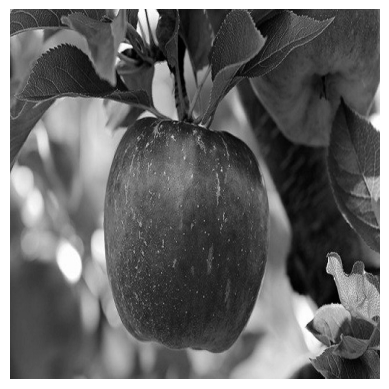

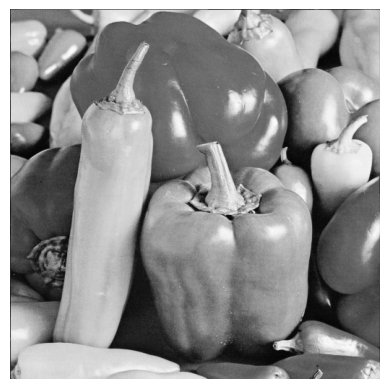

In [55]:
# 산술 연산 : 덧셈, 알파 연산(가중치를 곱하는 방식), 뺄셈
import cv2
import matplotlib.pyplot as plt
img1 = cv2.imread("../data/images/apple_512.jpg")
gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img2 = cv2.imread('../data/images/peppers.png')
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)
plt.imshow(gray1,cmap='gray')
plt.axis("off")
plt.show()
plt.imshow(gray2,cmap='gray')
plt.axis("off")
plt.show()

In [56]:
gray1.shape, gray2.shape

((512, 512), (512, 512))

In [57]:
height, width = gray1.shape
plus = gray1.copy()
minus = gray1.copy()
alpha = gray1.copy()
for i in range(height):
    for j in range(width):
        plus[i][j] = gray1[i][j] + gray2[i][j]
        minus[i][j] = gray1[i][j] - gray2[i][j]
        alpha[i][j] = gray1[i][j] * 0.7 + gray2[i][j] * (1 - 0.7)
        if plus[i][j] > 255:
            plus[i][j] = 255
        if minus[i][j] < 0:
            minus[i][j] = 0
        if alpha[i][j] > 255:
            alpha[i][j] = 255

C:\Users\tjoeun\AppData\Local\Temp\ipykernel_7144\578394024.py:8: RuntimeWarning: overflow encountered in ubyte_scalars
  minus[i][j] = gray1[i][j] - gray2[i][j]
C:\Users\tjoeun\AppData\Local\Temp\ipykernel_7144\578394024.py:7: RuntimeWarning: overflow encountered in ubyte_scalars
  plus[i][j] = gray1[i][j] + gray2[i][j]


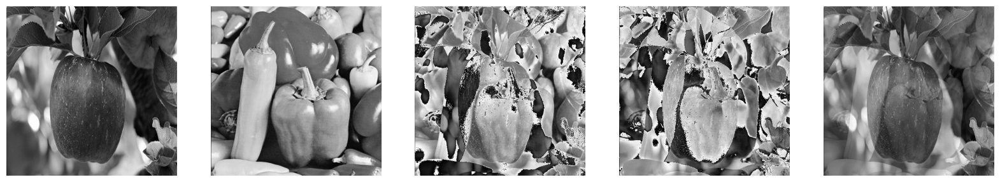

In [58]:
plt.figure(figsize=(20,6))
plt.subplot(1, 5, 1)
plt.imshow(gray1,cmap='gray')
plt.axis("off")
plt.subplot(1, 5, 2)
plt.imshow(gray2,cmap='gray')
plt.axis("off")
plt.subplot(1, 5, 3)
plt.imshow(plus,cmap='gray')
plt.axis("off")
plt.subplot(1, 5, 4)
plt.imshow(minus,cmap='gray')
plt.axis("off")
plt.subplot(1, 5, 5)
plt.imshow(alpha,cmap='gray')
plt.axis("off")
plt.show()
# 덧셈, 뺄셈: 0, 255 값이 많이 나타남, 어떤 값을 더하고 뺐는지 명확하지 않음
# 알파 연산: 가중치가 큰 이미지는 선명하게 보이고 가중치가 작은 이미지는 약하게 보임(워터마크 처리 등에 유용함)

16. 자르기

(384, 640, 3)


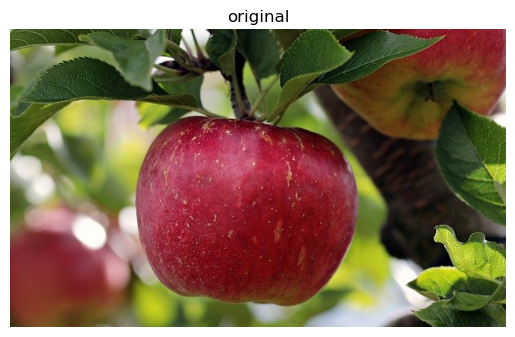

In [59]:
import cv2
import matplotlib.pyplot as plt
img = cv2.imread("../data/images/apple.jpg")
image_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
print(image_rgb.shape)
plt.imshow(image_rgb)
plt.title('original')
plt.axis("off")
plt.show()

In [60]:
dst1 = image_rgb[100:500, 200:600].copy()
dst2 = image_rgb.copy()
roi = image_rgb[100:300, 200:600]
# roi(Region of Interest)
dst2[0:200, 0:400] = roi

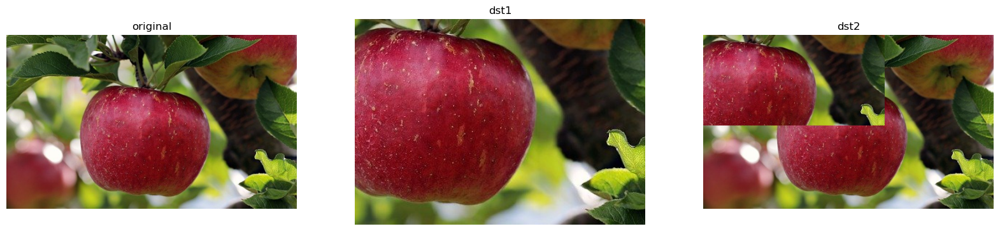

In [61]:
plt.figure(figsize=(20,8))
plt.subplot(1,3,1)
plt.imshow(image_rgb)
plt.title('original')
plt.axis("off")
plt.subplot(1,3,2)
plt.imshow(dst1)
plt.title('dst1')
plt.axis("off")
plt.subplot(1,3,3)
plt.imshow(dst2)
plt.title('dst2')
plt.axis("off")
plt.show()

17. 노이즈

In [62]:
# Gaussian Noise, 가우시안 노이즈
# 이미지의 압축, 전송 등의 과정에서 생기는 noise, 가우스 함수에 따른 분포(가우시안 분포, 정규분포)를 따른다.

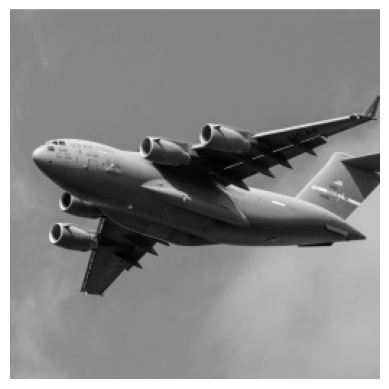

In [63]:
import cv2
import matplotlib.pyplot as plt
img = cv2.imread("../data/images/plane_256x256.jpg")
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
plt.imshow(gray,cmap='gray')
plt.axis("off")
plt.show()

In [64]:
import numpy as np
def make_noise(std, gray):
    height, width = gray.shape
    img_noise = np.zeros((height, width), dtype=float)
    for i in range(height):
        for a in range(width):
            make_noise = np.random.normal() # 랜덤함수를 이용하여 노이즈 적용
            set_noise = std * make_noise
            img_noise[i][a] = gray[i][a] + set_noise
        return img_noise

In [65]:
height, width = gray.shape
std = 20
img_noise = make_noise(std, gray)
img_noise2 = make_noise(std, gray)
img_noise3 = make_noise(std, gray)
img_noise4 = make_noise(std, gray)
out2 = np.zeros((height, width), dtype=float)
out3 = np.zeros((height, width), dtype=float)
out4 = np.zeros((height, width), dtype=float)

# 이미지 평균 연산
for i in range(height):
    for j in range(width):
        if (img_noise[i][j] + img_noise2[i][j]) / 2 > 255:
            out2[i][j] = 255
        else:
            out2[i][j] = (img_noise[i][j] + img_noise2[i][j]) / 2 # 2개의 이미지의 평균
        if (img_noise[i][j] + img_noise2[i][j] + img_noise3[i][j]) / 3 > 255:
            out3[i][j] = 255
        else:
            # 3개의 이미지의 평균
            out3[i][j] = (img_noise[i][j] + img_noise2[i][j] + img_noise3[i][j]) / 3
        if (img_noise[i][j] + img_noise2[i][j] + img_noise3[i][j] + img_noise4[i][j]) / 4 > 255:
            out4[i][j] = 255
        else:
            # 4개의 이미지의 평균
            out4[i][j] = (img_noise[i][j] + img_noise2[i][j] + img_noise3[i][j] + img_noise4[i][j]) / 4

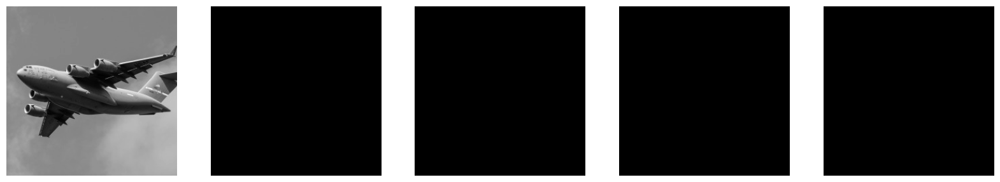

In [66]:
plt.figure(figsize=(20,6))
plt.subplot(1, 5, 1)
plt.imshow(gray,cmap='gray')
plt.axis("off")
plt.subplot(1, 5, 2)
plt.imshow(img_noise.astype(np.uint8),cmap='gray')
plt.axis("off")
plt.subplot(1, 5, 3)
plt.imshow(out2.astype(np.uint8),cmap='gray')
plt.axis("off")
plt.subplot(1, 5, 4)
plt.imshow(out3.astype(np.uint8),cmap='gray')
plt.axis("off")
plt.subplot(1, 5, 5)
plt.imshow(out4.astype(np.uint8),cmap='gray')
plt.axis("off")
plt.show()
# 1번: 원본 이미지
# 2번: 노이즈가 있는 이미지
# 3,4,5번으로 갈수록 노이즈가 감소하고 있음.

18. 노이즈제거 - 쿠와하라필터

In [67]:
# Kuwahara(쿠와하라) 필터 : 의료용 영상에 적합한 필터
# 가장자리를 흐리게 만들지 않으면서도 노이즈를 제거할 수 있는 필터

In [68]:
import cv2
import numpy as np
img = cv2.imread("../data/images/penguin.png")

In [69]:
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
height, width = gray.shape

# 노이즈 생성
img_noise = np.zeros_like(gray)
for i in range(height):
    for j in range(width):
        make_noise = np.random.normal()
        set_noise = 10 * make_noise
        img_noise[i][j] = gray[i][j] + set_noise

# 원본보다 +4의 크기로 생성(좌우 +2 제로패딩)
temp = np.zeros((height + 4, width + 4), dtype=float)
temp[2: 2 + height, 2: 2 + width] = img_noise.copy().astype(float)
out = np.zeros_like(gray)
for i in range(height):
    for j in range(width):
        point1 = temp[i:i + 3, j:j + 3]
        point2 = temp[i + 2:i + 5, j:j + 3]
        point3 = temp[i:i + 2, j + 2:j + 5]
        point4 = temp[i + 2:i + 5, j + 2:j + 5]
        if min(np.var(point1), np.var(point2), np.var(point3), np.var(point4)) == np.var(point1):
            out[i, j] = np.mean(temp[i:i + 3, j:j + 3])
        elif min(np.var(point1), np.var(point2), np.var(point3), np.var(point4)) == np.var(point2):
            out[i, j] = np.mean(temp[i + 2:i + 5, j:j + 3])
        elif min(np.var(point1), np.var(point2), np.var(point3), np.var(point4)) == np.var(point3):
            out[i, j] = np.mean(temp[i:i + 2, j + 2:j + 5])
        elif min(np.var(point1), np.var(point2), np.var(point3), np.var(point4)) == np.var(point4):
            out[i, j] = np.mean(temp[i + 2:i + 5, j + 2:j + 5])

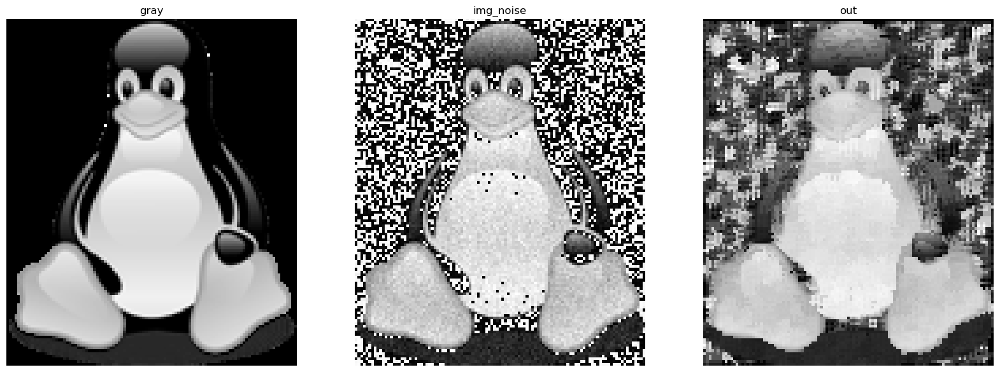

In [70]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.subplot(1, 3, 1)
plt.imshow(gray, cmap='gray')
plt.title('gray')
plt.axis("off")
plt.subplot(1, 3, 2)
plt.imshow(img_noise.astype(float), cmap='gray')
plt.title('img_noise')
plt.axis("off")
plt.subplot(1, 3, 3)
plt.imshow(out.astype(np.uint8), cmap='gray')
plt.title('out')
plt.axis("off")
plt.show()

19. 노이즈제거 - 알파-절삭 평균값 필터

In [71]:
# alpha-trimmed mean filtering(알파-절삭 평균값 필터링)
# 가중치(알파)를 두어 일부를 자르고(절삭) 그 값들의 평균값을 취하는 방식

In [72]:
import cv2
import numpy as np
img = cv2.imread("../data/images/penguin.png")

In [73]:
height, width, channel = img.shape
# salt and pepper noise를 만드는 코드
# 이미지에 희고(salt - 소금) 검은(pepper - 후추) 노이즈
alpha=0.3
noise = img.copy()
salt = int(height * width * 0.1)
for i in range(salt):
    row = int(np.random.randint(99999, size=1) % height)
    col = int(np.random.randint(99999, size=1) % width)
    ch = int(np.random.randint(99999, size=1) % channel)
    noise[row][col][ch] = 255 if np.random.randint(99999, size=1) % 2 == 1 else 0
# 노이즈 제거
out = np.zeros((height + 1, width + 1, channel), dtype=float) # 제로 패딩
out[1:1 + height, 1:1 + width] = img.copy().astype(float)
temp = out.copy()
for i in range(height):
    for j in range(width):
        for k in range(channel):
            mean = np.sort(np.ravel(temp[i:i + 3, j:j + 3, k]))
            out[1 + i, 1 + j, k] = np.mean(mean[int(alpha * 9):-int(alpha * 9)])
out = out[1:1 + height, 1:1 + width].astype(np.uint8)

C:\Users\tjoeun\AppData\Roaming\Python\Python39\site-packages\numpy\core\fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\tjoeun\AppData\Roaming\Python\Python39\site-packages\numpy\core\_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


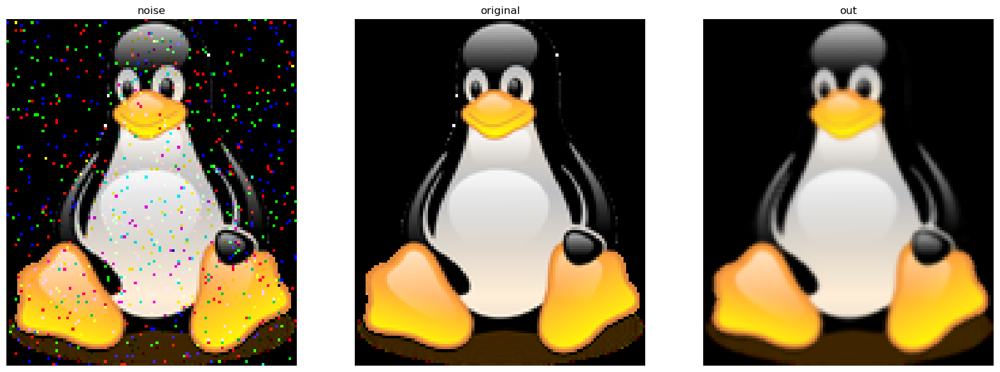

In [74]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.subplot(1, 3, 1)
noise = cv2.cvtColor(noise, cv2.COLOR_BGR2RGB)
plt.imshow(noise)
plt.title('noise')
plt.axis("off")
plt.subplot(1, 3, 2)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.title('original')
plt.axis("off")
plt.subplot(1, 3, 3)
out = cv2.cvtColor(out, cv2.COLOR_BGR2RGB)
plt.imshow(out)
plt.title('out')
plt.axis("off")
plt.show()

20. 비트연산

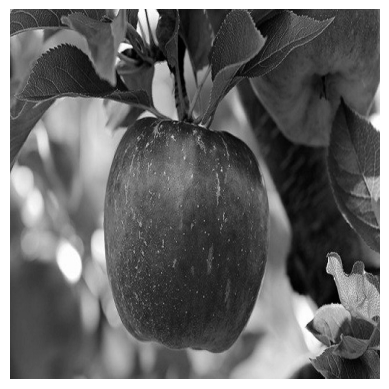

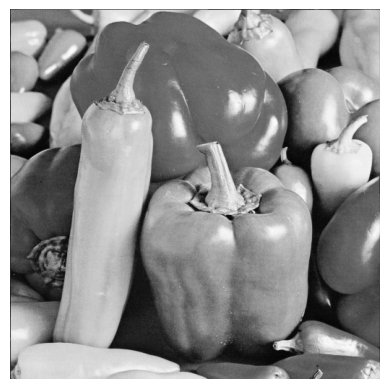

In [75]:
import cv2
import matplotlib.pyplot as plt
img1 = cv2.imread("../data/images/apple_512.jpg")
gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img2 = cv2.imread('../data/images/peppers.png')
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)
plt.imshow(gray1,cmap='gray')
plt.axis("off")
plt.show()
plt.imshow(gray2,cmap='gray')
plt.axis("off")
plt.show()

In [76]:
ret1, out1 = cv2.threshold(gray1, 128, 255, cv2.THRESH_BINARY)
ret2, out2 = cv2.threshold(gray2, 128, 255, cv2.THRESH_BINARY)
bit_and = cv2.bitwise_and(out1, out2)
bit_or = cv2.bitwise_or(out1, out2)
bit_not = cv2.bitwise_not(out1)
bit_xor = cv2.bitwise_xor(out1, out2)

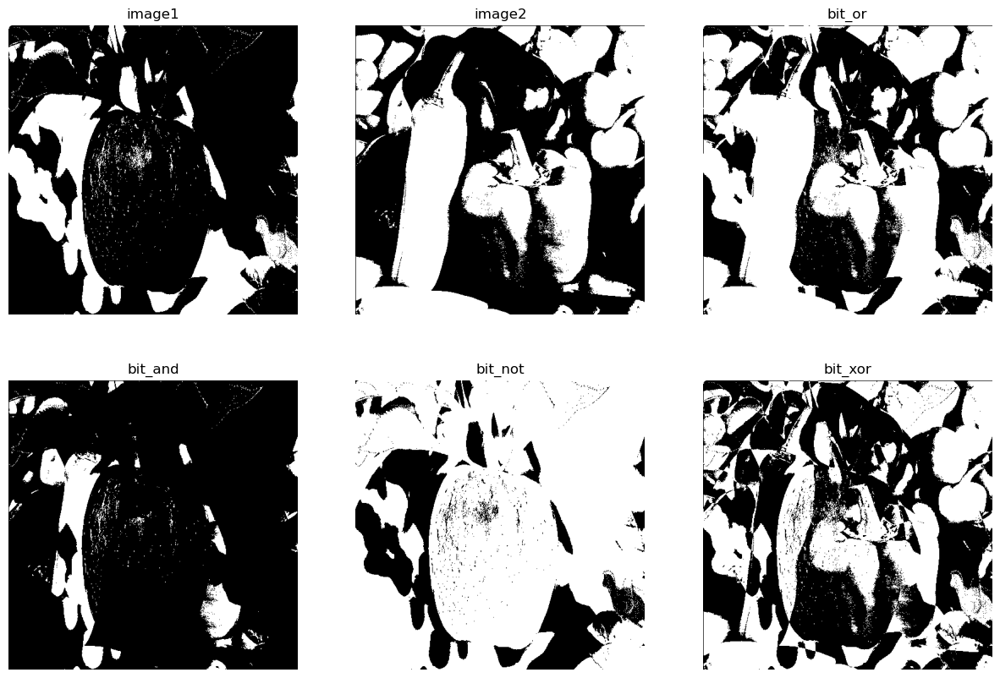

In [77]:
plt.figure(figsize=(15,10))
plt.subplot(2, 3, 1)
plt.imshow(out1,cmap='gray')
plt.title('image1')
plt.axis("off")
plt.subplot(2, 3, 2)
plt.imshow(out2,cmap='gray')
plt.title('image2')
plt.axis("off")
plt.subplot(2, 3, 3)
plt.imshow(bit_or,cmap='gray')
plt.title('bit_or')
plt.axis("off")
plt.subplot(2, 3, 4)
plt.imshow(bit_and,cmap='gray')
plt.title('bit_and')
plt.axis("off")
plt.subplot(2, 3, 5)
plt.imshow(bit_not,cmap='gray')
plt.title('bit_not')
plt.axis("off")
plt.subplot(2, 3, 6)
plt.imshow(bit_xor,cmap='gray')
plt.title('bit_xor')
plt.axis("off")
plt.show()

21. 비트연산2

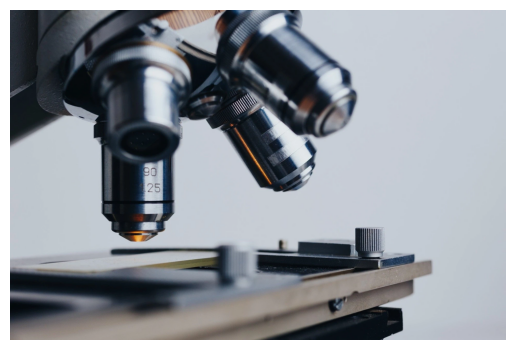

In [78]:
import cv2
import matplotlib.pyplot as plt
img = cv2.imread("../data/images/analysis.jpg")
src = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(src)
plt.axis("off")
plt.show()

In [79]:
import numpy as np
import cv2
gray = cv2.cvtColor(src, cv2.COLOR_BGR2GRAY)

# 이진화 이미지(임계값 127)
_, binary = cv2.threshold(gray, 127, 255, cv2.THRESH_BINARY)
_and = cv2.bitwise_and(gray, binary)
_or = cv2.bitwise_or(gray, binary)
_xor = cv2.bitwise_xor(gray, binary)
_not = cv2.bitwise_not(gray)
src = np.concatenate((np.zeros_like(gray), gray, binary, np.zeros_like(gray)), axis = 1)
dst = np.concatenate((_and, _or, _xor, _not), axis = 1)
dst = np.concatenate((src, dst), axis = 0)

22. 비트연산-reverse

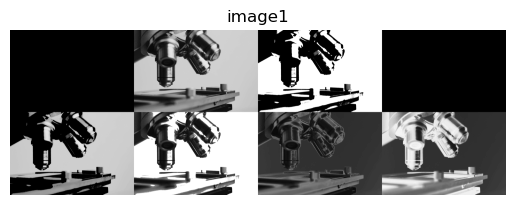

(427, 640, 3)

In [80]:
plt.imshow(dst,cmap='gray')
plt.title('image1')
plt.axis("off")
plt.show()
import cv2
import matplotlib.pyplot as plt
img = cv2.imread("../data/images/winter.jpg")
image_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
image_rgb.shape

In [81]:
dst = cv2.bitwise_not(img)

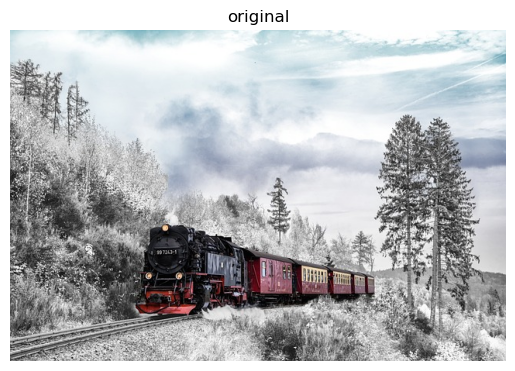

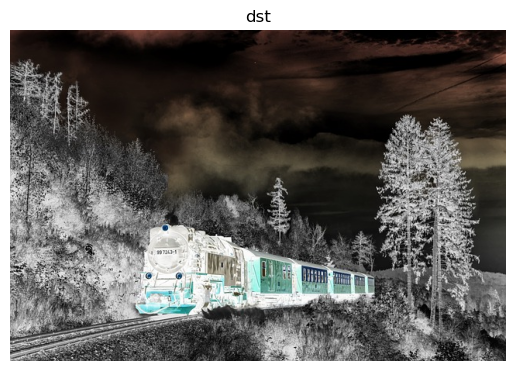

In [82]:
plt.imshow(image_rgb)
plt.title('original')
plt.axis("off")
plt.show()
image_rgb = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)
plt.imshow(image_rgb)
plt.title('dst')
plt.axis("off")
plt.show()

23. 엠보싱

In [83]:
# embossing
# 튀어나오게 하는 방식(엠보싱, 양각), 들어가게 하는 방식(디보싱, 음각)

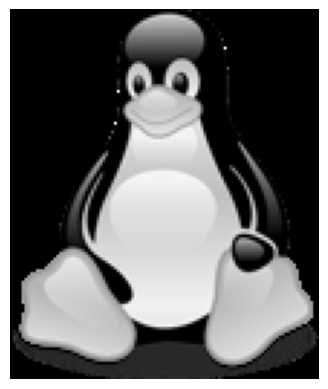

In [84]:
import cv2
import matplotlib.pyplot as plt
img = cv2.imread("../data/images/penguin.png")
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
plt.imshow(gray,cmap='gray')
plt.axis("off")
plt.show()

In [85]:
import cv2
import numpy as np

# 음각
mask1 = np.array([[-1, 0, 0], 
                  [0, 0, 0], 
                  [0, 0, 1]])

# 양각
mask2 = np.array([[1, 1, 1],
                  [1, -8, 1],
                  [1, 1, 1]])

# 원본, 깊이, 마스크
out1 = cv2.filter2D(gray, -1, mask1)
out2 = cv2.filter2D(gray, -1, mask2)

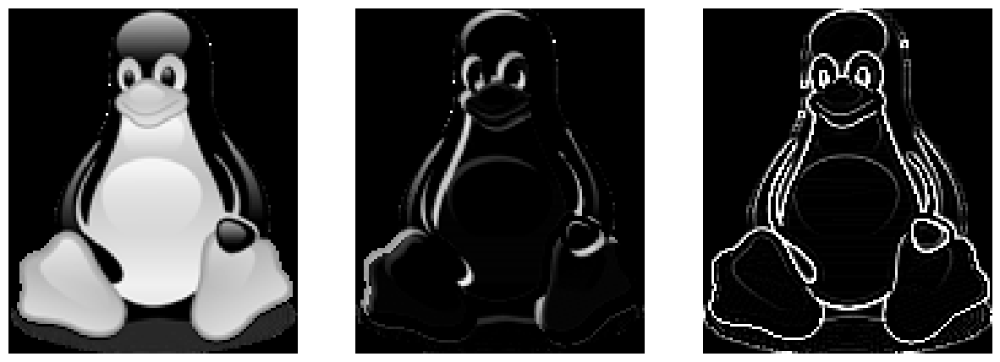

In [86]:
plt.figure(figsize=(15,10))
plt.subplot(1, 3, 1)
plt.imshow(gray,cmap='gray')
plt.axis("off")
plt.subplot(1, 3, 2)
plt.imshow(out1,cmap='gray')
plt.axis("off")
plt.subplot(1, 3, 3)
plt.imshow(out2,cmap='gray')
plt.axis("off")
plt.show()

24. 블러링-스무딩-샤프닝

In [87]:
# 블러링 - 흐리게
# 스무딩 - 부드럽게
# 샤프닝 - 날카롭게

In [88]:
import cv2
import numpy as np
img = cv2.imread("../data/images/autumn.jpg")
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# 블러링(픽셀의 평균값)
# 블러링 마스크의 크기가 크면 영상이 흐려짐
# 1/n
# 3x3 , 모두 더하면 1
blurring_mask1 = np.array([[1 / 9, 1 / 9, 1 / 9],
                           [1 / 9, 1 / 9, 1 / 9],
                           [1 / 9, 1 / 9, 1 / 9]])

# 5x5
blurring_mask2 = np.array([[1 / 25, 1 / 25, 1 / 25, 1 / 25, 1 / 25],
                           [1 / 25, 1 / 25, 1 / 25, 1 / 25, 1 / 25],
                           [1 / 25, 1 / 25, 1 / 25, 1 / 25, 1 / 25],
                           [1 / 25, 1 / 25, 1 / 25, 1 / 25, 1 / 25],
                           [1 / 25, 1 / 25, 1 / 25, 1 / 25, 1 / 25]])

# 스무딩 : 경계선이 뚜렷해짐
smoothing_mask = np.array([[1 / 16, 1 / 8, 1 / 16],
                           [1 / 8, 1 / 4, 1 / 8],
                           [1 / 16, 1 / 8, 1 / 16]])

# 샤프닝
# 중앙값 9, 나머지 픽셀 -1x8, 모두 더하면 1
# 중앙값이 클수록 원본 영상보다 거친 느낌
sharpening_mask1 = np.array([[-1, -1, -1],
                             [-1, 9, -1],
                             [-1, -1, -1]])
sharpening_mask2 = np.array([[0, -1, 0],
                             [-1, 5, -1],
                             [0, -1, 0]])
blurring_out1 = cv2.filter2D(gray, -1, blurring_mask1)
blurring_out2 = cv2.filter2D(gray, -1, blurring_mask2)
smoothing_out = cv2.filter2D(gray, -1, smoothing_mask)
sharpening_out1 = cv2.filter2D(gray, -1, sharpening_mask1)
sharpening_out2 = cv2.filter2D(gray, -1, sharpening_mask2)

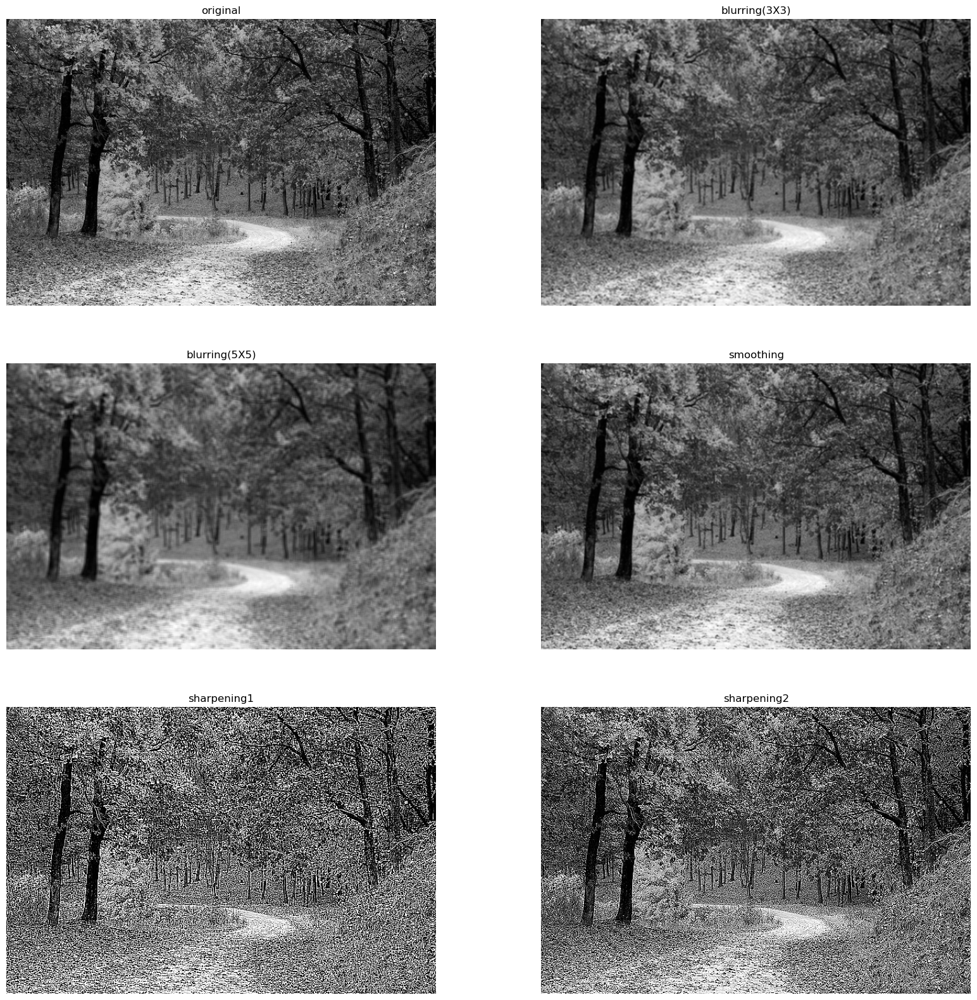

In [90]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,20))
plt.subplot(3, 2, 1)
plt.imshow(gray,cmap='gray')
plt.title('original')
plt.axis("off")
plt.subplot(3, 2, 2)
plt.imshow(blurring_out1,cmap='gray')
plt.title('blurring(3X3)')
plt.axis("off")
plt.subplot(3, 2, 3)
plt.imshow(blurring_out2,cmap='gray')
plt.title('blurring(5X5)')
plt.axis("off")
plt.subplot(3, 2, 4)
plt.imshow(smoothing_out,cmap='gray')
plt.title('smoothing')
plt.axis("off")
plt.subplot(3, 2, 5)
plt.imshow(sharpening_out1,cmap='gray')
plt.title('sharpening1')
plt.axis("off")
plt.subplot(3, 2, 6)
plt.imshow(sharpening_out2,cmap='gray')
plt.title('sharpening2')
plt.axis("off")
plt.show()

25. CMYK 분리

In [91]:
# 색의 3원색은 CMY(K)
# Cyan(청록), Magenta(자주), Yellow(노랑), blacK(검정)

In [94]:
import cv2
import numpy as np
img = cv2.imread("../data/images/apple.jpg")

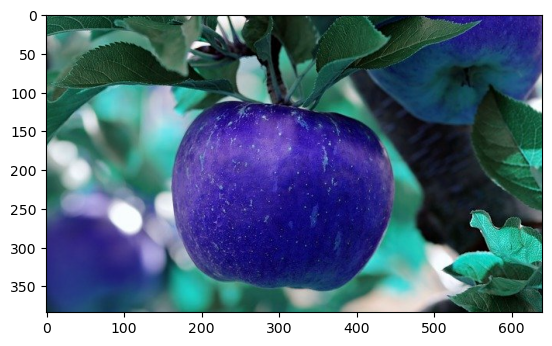

In [95]:
import matplotlib.pyplot as plt
plt.imshow(img)
plt.show()

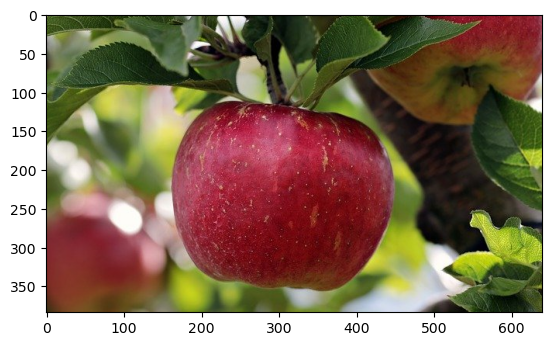

In [96]:
# BGR을 RGB로 변환
image_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(image_rgb)

In [97]:
bgr = img.astype(float) / 255.0
bgr.shape

(384, 640, 3)

In [98]:
k = 1 - np.max(bgr, axis=2) # axis 0 1차원, 1 2차원, 2 3차원
c = (1 - bgr[..., 2] - k) / (1 - k)
m = (1 - bgr[..., 1] - k) / (1 - k)
y = (1 - bgr[..., 0] - k) / (1 - k)
cmyk = (np.dstack((c, m, y, k)) * 255).astype(np.uint8)

C:\Users\tjoeun\AppData\Local\Temp\ipykernel_7144\3043032573.py:2: RuntimeWarning: invalid value encountered in divide
  c = (1 - bgr[..., 2] - k) / (1 - k)
C:\Users\tjoeun\AppData\Local\Temp\ipykernel_7144\3043032573.py:3: RuntimeWarning: invalid value encountered in divide
  m = (1 - bgr[..., 1] - k) / (1 - k)
C:\Users\tjoeun\AppData\Local\Temp\ipykernel_7144\3043032573.py:4: RuntimeWarning: invalid value encountered in divide
  y = (1 - bgr[..., 0] - k) / (1 - k)


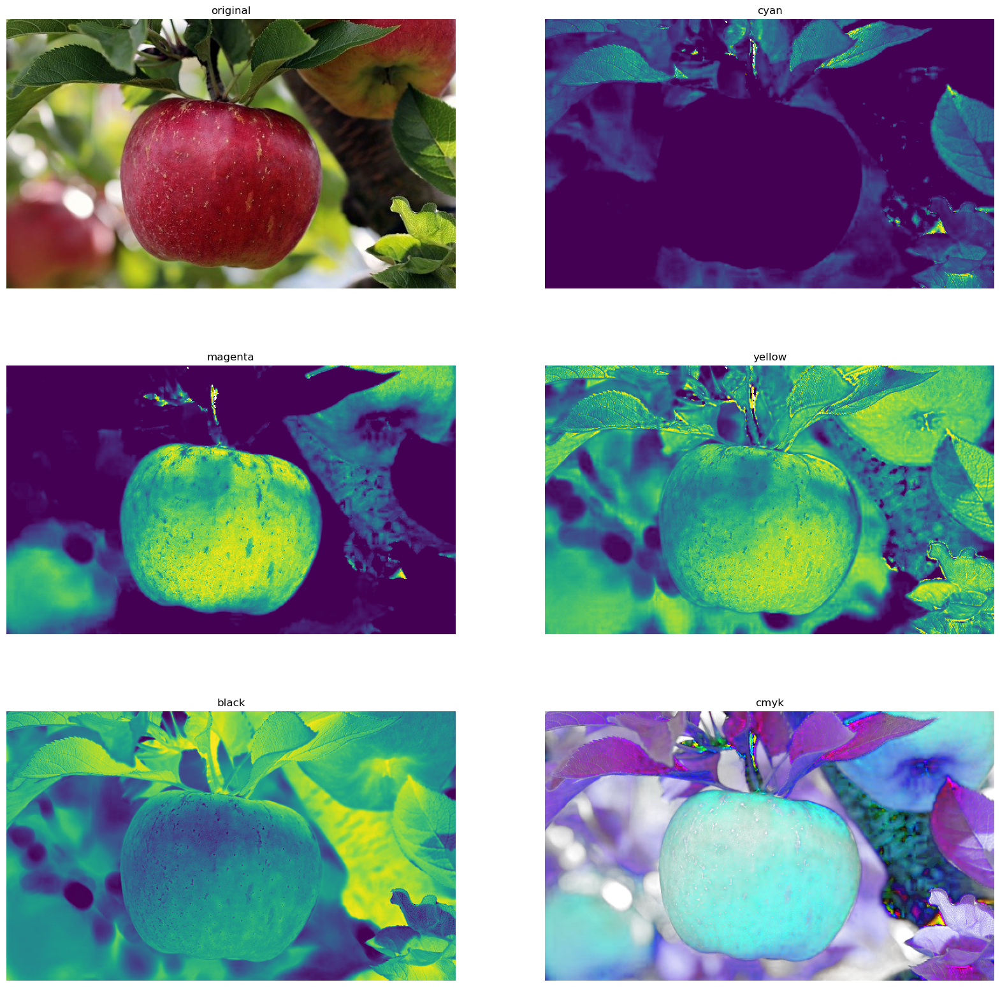

In [99]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,20))
plt.subplot(3, 2, 1)
plt.imshow(image_rgb)
plt.title('original')
plt.axis("off")
plt.subplot(3, 2, 2)
plt.imshow(c)
plt.title('cyan')
plt.axis("off")
plt.subplot(3, 2, 3)
plt.imshow(m)
plt.title('magenta')
plt.axis("off")
plt.subplot(3, 2, 4)
plt.imshow(y)
plt.title('yellow')
plt.axis("off")
plt.subplot(3, 2, 5)
plt.imshow(k)
plt.title('black')
plt.axis("off")
# cmyk를 분리한 후 합친 이미지이므로 원본과 다른 모양
plt.subplot(3, 2, 6)
plt.imshow(cmyk)
plt.title('cmyk')
plt.axis("off")
plt.show()

26. 엣지검출

In [100]:
# edge 검출
# edge : 밝기가 낮은 값에서 높은 값으로, 또는 높은 값에서 낮은 값으로 변하는 지점, 영상을 구성하는 객체 간의 경계선
# Homogeneity(유사 연산자) : 계산하고자 하는 원래의 pixel을 center로 잡고, 그 주변의 pixel 과의 뺄셈을 통해 계산하는 방식, 가장 큰 값을 저장, 오래 걸리는 방식
# Difference(차 연산자) : Homogeneity 보다 빠른 방식

In [101]:
import cv2
import numpy as np
img = cv2.imread("../data/images/penguin.png")

In [102]:
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
height, width = gray.shape
homo = np.zeros(gray.shape, dtype=np.uint8)
diff = np.zeros(gray.shape, dtype=np.uint8)
for i in range(height):
    for j in range(width):
        a = []
        for x in [-1, 0, 1]:
            for y in [-1, 0, 1]:
                if x == 0 and y == 0:
                    continue
                try:
                    center = int(gray[i][j])
                    m = int(gray[i + x][j + y])
                    a.append(abs(center - m))
                except:
                    continue
                homo[i][j] = max(a)
for i in range(height):
    for j in range(width):
        a = []
        for k in [-1, 0, 1]:
            try:
                b = int(abs(gray[i - 1][j - k]))
                c = int(abs(gray[i + 1][j + k]))
                a.append(abs(b - c))
            except:
                continue
        try:
            b = int(abs(gray[i][j - 1]))
            c = int(abs(gray[i][j + 1]))
            a.append(abs(b - c))
        except:
            continue
        diff[i][j] = max(a)

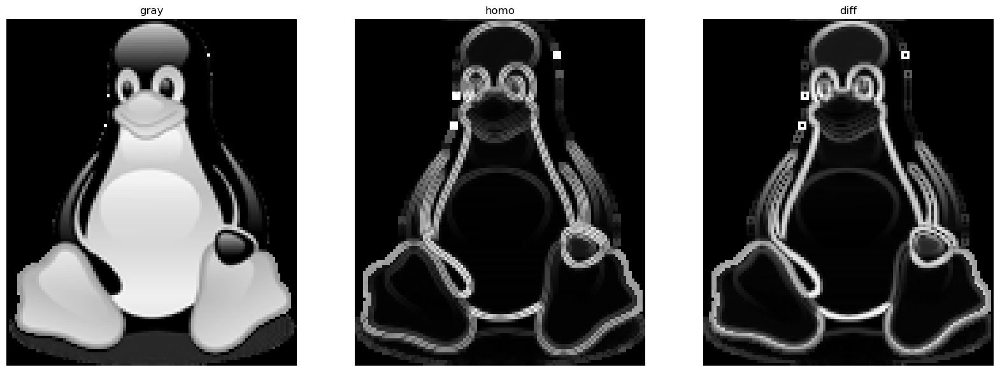

In [103]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,20))
plt.subplot(1, 3, 1)
plt.imshow(gray, cmap='gray')
plt.title('gray')
plt.axis("off")
plt.subplot(1, 3, 2)
plt.imshow(homo, cmap='gray')
plt.title('homo')
plt.axis("off")
plt.subplot(1, 3, 3)
plt.imshow(diff, cmap='gray')
plt.title('diff')
plt.axis("off")
plt.show()

27. 엣지검출 - Laplacian-LoG-DoG

In [104]:
import cv2
import numpy as np
img = cv2.imread("../data/images/penguin.png")

In [105]:
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
height, width = gray.shape
mask1 = np.array([[0, -1, 0],
                  [-1, 4, -1],
                  [0, -1, 0]])
mask2 = np.array([[1, 1, 1],
                  [1, -8, 1],
                  [1, 1, 1]])
mask3 = np.array([[-1, -1, -1],
                  [-1, 8, -1],
                  [-1, -1, -1]])

# 라플라시안 필터 : 2차 미분, 기울기의 기울기, 좀더 정확한 edge를 검출하기 위해 사용됨
laplacian1 = cv2.filter2D(gray, -1, mask1)
laplacian2 = cv2.filter2D(gray, -1, mask2)
laplacian3 = cv2.filter2D(gray, -1, mask3)
laplacian4 = cv2.Laplacian(gray, -1) # 라플라시안 함수, mask1 적용
# LoG : Laplacian of Gaussian(더 선명한 edge 검출)
# 가우시안 블러를 적용한 후 라플라시안을 사용하는 필터
gaussian = cv2.GaussianBlur(gray, (5, 5), 0)
# (적용할 이미지, 필터 크기, 알파값), 알파값이 커지면 블러링이 강하게 적용됨
LoG = cv2.filter2D(gaussian, -1, mask3)
# DoG : Difference of Gaussian
# 가우시안 블러를 적용한 이미지의 difference
# 가장 적합한 값은 1.6 : 1
gaussian1 = cv2.GaussianBlur(gray, (5, 5), 1.6)
gaussian2 = cv2.GaussianBlur(gray, (5, 5), 1)
DoG = np.zeros_like(gray)
for i in range(height):
    for j in range(width):
        DoG[i][j] = float(gaussian1[i][j]) - float(gaussian2[i][j])

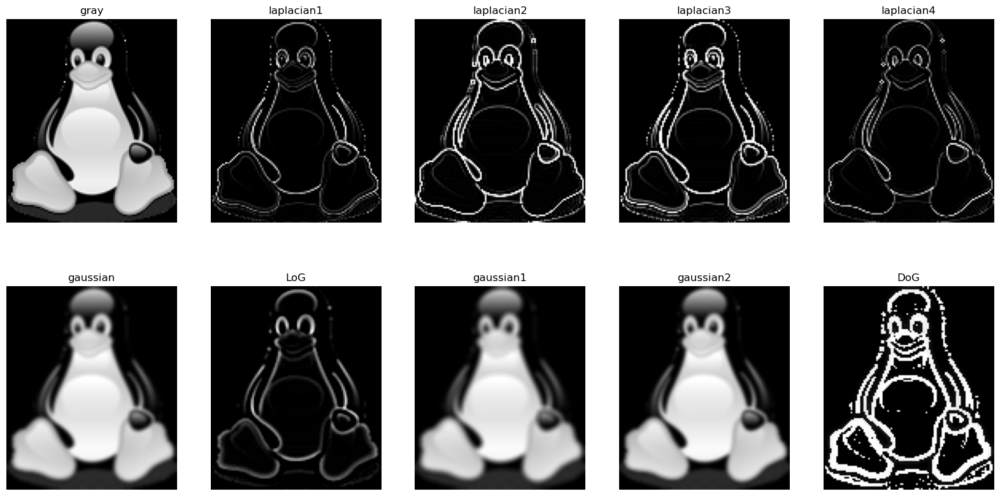

In [106]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.subplot(2, 5, 1)
plt.imshow(gray, cmap='gray')
plt.title('gray')
plt.axis("off")
plt.subplot(2, 5, 2)
plt.imshow(laplacian1.astype(float), cmap='gray')
plt.title('laplacian1')
plt.axis("off")
plt.subplot(2, 5, 3)
plt.imshow(laplacian2.astype(float), cmap='gray')
plt.title('laplacian2')
plt.axis("off")
plt.subplot(2, 5, 4)
plt.imshow(laplacian3.astype(float), cmap='gray')
plt.title('laplacian3')
plt.axis("off")
plt.subplot(2, 5, 5)
plt.imshow(laplacian4.astype(float), cmap='gray')
plt.title('laplacian4')
plt.axis("off")
plt.subplot(2, 5, 6)
plt.imshow(gaussian, cmap='gray')
plt.title('gaussian')
plt.axis("off")
plt.subplot(2, 5, 7)
plt.imshow(LoG.astype(float), cmap='gray')
plt.title('LoG')
plt.axis("off")
plt.subplot(2, 5, 8)
plt.imshow(gaussian1, cmap='gray')
plt.title('gaussian1')
plt.axis("off")
plt.subplot(2, 5, 9)
plt.imshow(gaussian2, cmap='gray')
plt.title('gaussian2')
plt.axis("off")
plt.subplot(2, 5, 10)
plt.imshow(DoG, cmap='gray')
plt.title('DoG')
plt.axis("off")
plt.show()